In [1]:
import sys

sys.path.append("../")
from tensorflow.keras.applications.vgg19 import VGG19
from funciones import *
##CudNN Error
import tensorflow as tf
config=tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth=True
sess=tf.compat.v1.Session(config=config)

Modulo importado con exito.... :)


In [2]:
K.clear_session() #limpiamos todos en caso de nuevo entrenamiento
img_width=224
img_height=224
INIT_LR = 1e-3
batch_size=50
epochs=200

#CARGANDO LOS DATASETS
path_root='../../Dataset Real Bananos MRefinados/'
path_train=path_root+'train'
path_validation=path_root+'validation'

train_gen=ImageDataGenerator(
    rescale=1./255,
    shear_range=0.3,
    zoom_range=0.3,
    horizontal_flip=True
)

validation_gen= ImageDataGenerator(rescale=1./255)

image_train=train_gen.flow_from_directory(
    path_train,
    target_size=(img_width,img_height),
    batch_size=batch_size,
    class_mode='categorical',
)

image_validation=validation_gen.flow_from_directory(
    path_validation,
    target_size=(img_width,img_height),
    batch_size=batch_size,
    class_mode='categorical'
)
nClasses=len(image_train.class_indices)
print(image_train.class_indices)

Found 2384 images belonging to 4 classes.
Found 795 images belonging to 4 classes.
{'Class A': 0, 'Class B': 1, 'Class C': 2, 'Class D': 3}


In [3]:
#Construccion del modelo

vgg19_arch=VGG19(input_shape=(img_width,img_height,3),
                                 weights=None, #aqui se puede aplicarTransfer Learning
                                 include_top=False)
vgg19_arch.summary()

Model: "vgg19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 224, 224, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0     

In [4]:
model = Sequential()
model.add(vgg19_arch)
model.add(Flatten())
model.add(Dropout(0.2))
model.add(Dense(1024, activation='relu', kernel_constraint=maxnorm(3)))
model.add(Dropout(0.2))
model.add(Dense(512, activation='relu', kernel_constraint=maxnorm(3)))
model.add(Dropout(0.2))
model.add(Dense(nClasses, activation='softmax'))

model.compile(loss=keras.losses.categorical_crossentropy, 
    optimizer=keras.optimizers.Adagrad(lr=INIT_LR, decay=INIT_LR / 100),
    metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Functional)           (None, 7, 7, 512)         20024384  
_________________________________________________________________
flatten (Flatten)            (None, 25088)             0         
_________________________________________________________________
dropout (Dropout)            (None, 25088)             0         
_________________________________________________________________
dense (Dense)                (None, 1024)              25691136  
_________________________________________________________________
dropout_1 (Dropout)          (None, 1024)              0         
_________________________________________________________________
dense_1 (Dense)              (None, 512)               524800    
_________________________________________________________________
dropout_2 (Dropout)          (None, 512)               0

In [5]:
step_train=image_train.n//image_train.batch_size
step_validation=image_validation.n//image_validation.batch_size

In [6]:



#EMPEZANDO EL ENTRENAMIENTO

history=model.fit_generator(image_train,
                  steps_per_epoch=step_train,
                  epochs=epochs,
                  #callbacks=[early_stop, tfdocs.modeling.EpochDots()],
                  verbose=1,
                  validation_data=image_validation,
                  validation_steps=step_validation
                  )


Instructions for updating:
Please use Model.fit, which supports generators.
Epoch 1/200


ResourceExhaustedError:  OOM when allocating tensor with shape[50,64,224,224] and type float on /job:localhost/replica:0/task:0/device:GPU:0 by allocator GPU_0_bfc
	 [[node sequential/vgg19/block1_conv1/Relu (defined at <ipython-input-6-4fca2f32a00f>:3) ]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info.
 [Op:__inference_train_function_2132]

Function call stack:
train_function


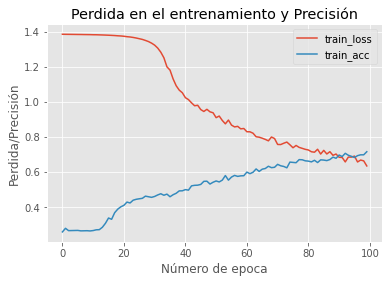

In [8]:
plt.style.use("ggplot")
plt.figure()
plt.plot(np.arange(0,epochs),history.history['loss'],label="train_loss")
plt.plot(np.arange(0,epochs),history.history['accuracy'],label="train_acc")
plt.title("Perdida en el entrenamiento y Precisión")
plt.xlabel("Número de epoca")
plt.ylabel("Perdida/Precisión")
plt.legend(loc="upper right")
plt.show()

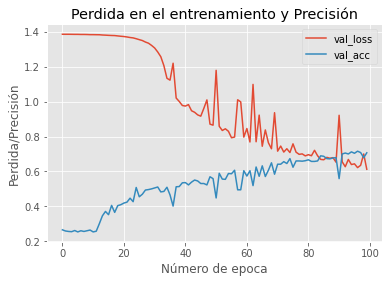

In [9]:
plt.plot(np.arange(0,epochs),history.history['val_loss'],label="val_loss")
plt.plot(np.arange(0,epochs),history.history['val_accuracy'],label="val_acc")
plt.title("Perdida en el entrenamiento y Precisión")
plt.xlabel("Número de epoca")
plt.ylabel("Perdida/Precisión")
plt.legend(loc="upper right")
plt.show()

In [8]:
test_datagen=ImageDataGenerator(preprocessing_function=preprocess_input)
path_test=path_root+"test_junto"
test_gen=test_datagen.flow_from_directory(
    path_test,
    target_size=(img_width,img_height),
    color_mode='rgb',
    batch_size=1,
    class_mode=None,
    shuffle=False,
    seed=42
)

Found 800 images belonging to 1 classes.


In [9]:
steps_size_test=test_gen.n//test_gen.batch_size
pred=model.predict_generator(test_gen,steps=steps_size_test,verbose=1)
predicted_class_index=np.argmax(pred,axis=1)
print(predicted_class_index)

Instructions for updating:
Please use Model.predict, which supports generators.
800/800 [==============================] - 5s 7ms/step
[0 0 0 0 2 0 1 0 0 3 1 0 1 1 0 1 0 0 0 0 1 2 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0
 0 0 0 0 0 1 1 1 1 0 0 0 0 0 1 1 0 0 0 0 1 0 0 0 0 0 1 0 0 0 1 0 0 3 1 0 0
 1 0 1 0 0 0 0 0 0 0 0 0 1 0 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 1 0 1 0 0 0 0 1
 0 3 1 0 1 0 0 0 0 0 0 1 0 0 0 0 0 0 1 1 1 0 2 3 0 0 0 0 0 0 1 0 0 0 0 0 1
 1 0 0 0 0 0 0 0 2 0 1 0 0 1 0 0 0 0 1 0 0 0 0 0 0 1 0 0 0 3 0 0 0 0 1 0 0
 0 1 0 0 0 0 3 0 0 0 0 0 0 0 0 1 0 0 0 1 0 0 0 0 0 0 1 1 1 1 1 1 1 0 0 0 2
 1 3 0 0 1 1 1 0 0 1 0 0 1 1 1 0 1 0 0 2 2 2 1 2 1 1 1 0 1 0 0 1 3 0 1 1 2
 0 0 0 1 0 1 0 3 0 1 0 1 2 2 0 0 3 0 1 0 1 0 1 0 1 0 1 1 2 3 2 2 0 0 1 0 0
 0 0 0 2 1 0 0 1 1 1 0 1 3 2 0 0 1 2 1 3 1 0 1 1 1 1 1 1 0 1 1 1 0 1 3 0 0
 1 1 1 0 1 0 0 1 1 1 0 1 1 1 2 3 1 0 0 0 2 1 1 0 0 1 1 0 0 0 2 0 0 2 2 2 0
 0 3 0 1 2 0 2 1 0 3 0 2 1 0 2 3 0 2 2 0 0 0 1 0 0 1 0 1 0 1 1 0 0 0 2 0 0
 3 1 2 1 1 1 1 1 1 0 0 2 0 2 3 0 1 0 0 2

In [10]:
labels=(image_train.class_indices)
labels=dict((v,k) for k,v in labels.items())
predictions=[labels[k] for k in predicted_class_index]

In [11]:
filenames=test_gen.filenames
results=pd.DataFrame({"Filenames":filenames,
                        "Prdicciones":predictions})
results                     

,Filenames,Prdicciones
0,test\7000_tipoB.png,Class A
1,test\7001_tipoB.png,Class A
2,test\7002_tipoB.png,Class A
3,test\7003_tipoB.png,Class A
4,test\7004_tipoB.png,Class C
...,...,...
795,test\981_tipoA.png,Class A
796,test\982_tipoA.png,Class A
797,test\983_tipoA.png,Class A
798,test\984_tipoB.png,Class A


In [12]:
real_class_indices=[]
for i in range(0,len(filenames)):
    your_path=filenames[i]
    path_list=your_path.split(os.sep)
    if("tipoA" in path_list[1]):
        real_class_indices.append(0)
    if("tipoB" in path_list[1]):
        real_class_indices.append(1)
    if("tipoC" in path_list[1]):
        real_class_indices.append(2)
    if("tipoD" in path_list[1]):
        real_class_indices.append(3)
print(len(real_class_indices))
print(real_class_indices)

800
[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 2, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 2, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, 0, 2, 2, 3, 2, 2, 2, 3, 2, 2, 2, 0, 2, 2, 2, 3, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 1, 2, 2, 1, 2, 0, 2, 2, 3, 2, 2, 2, 1, 1, 1, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 3, 3, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 2, 2, 2,

In [15]:
df_test_reales=pd.DataFrame({"Filenames":filenames,
                        "Predicciones_v":real_class_indices})
df_test_reales

,Filenames,Predicciones_v
0,test\7000_tipoB.png,1
1,test\7001_tipoB.png,1
2,test\7002_tipoB.png,1
3,test\7003_tipoB.png,1
4,test\7004_tipoB.png,1
...,...,...
795,test\981_tipoA.png,0
796,test\982_tipoA.png,0
797,test\983_tipoA.png,0
798,test\984_tipoB.png,1


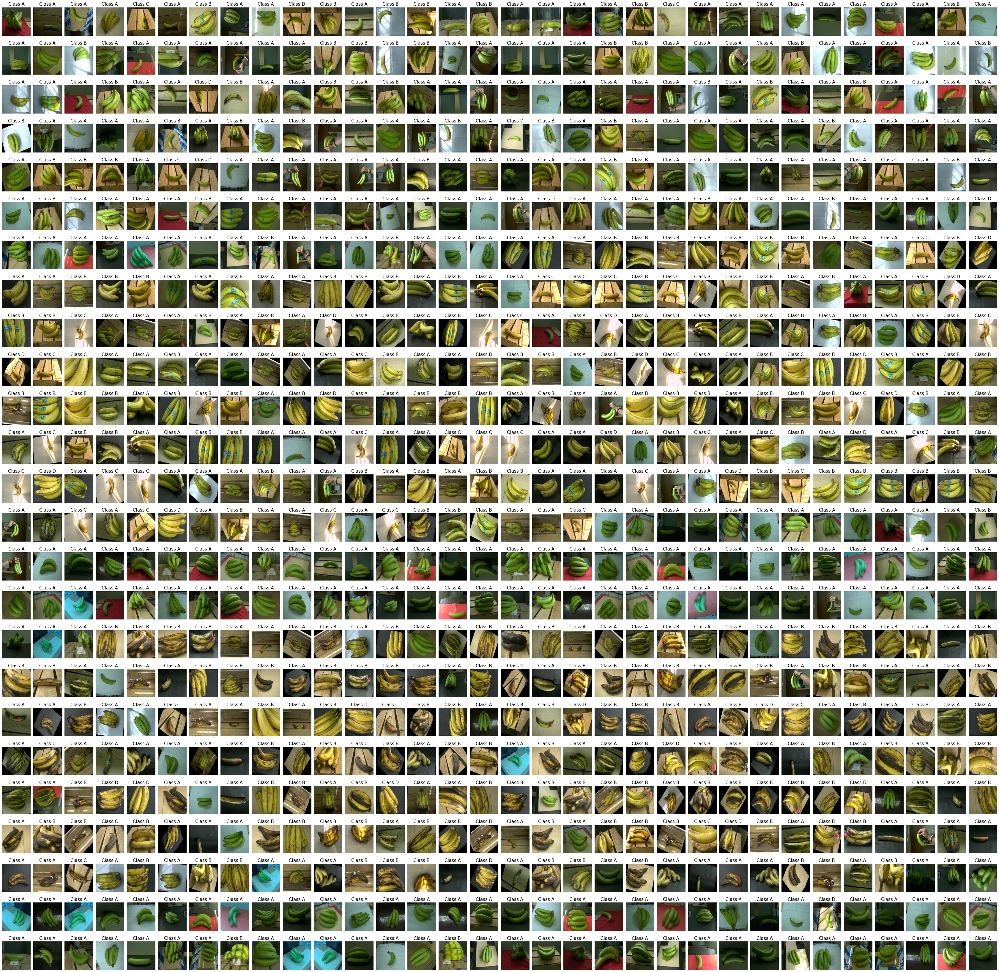

In [16]:
import matplotlib.image as mpimg

fig=plt.figure(figsize=(60,60))
fig.subplots_adjust(hspace=0.1,wspace=0.1)
rows=25
cols=len(filenames)//rows if len(filenames)%2==0 else len(filenames)//rows + 1
for i in range(0,len(filenames)):
    your_path=filenames[i]
    path_list=your_path.split(os.sep)
    img=mpimg.imread(path_test+"/test/"+path_list[1])
    ax=fig.add_subplot(rows,cols,i+1)
    ax.axis("Off")
    plt.imshow(img,interpolation=None)
    ax.set_title(predictions[i],fontsize=15)

In [13]:
from mlxtend.evaluate import confusion_matrix
from itertools import product 

matriz_conf=confusion_matrix(real_class_indices,predicted_class_index)
def plot_matriz_conf(cm,classes,normalize=False,title="Matriz de Confusión",cmap=plt.cm.Blues):
    plt.imshow(cm,interpolation="nearest",cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks=np.arange(len(classes))
    plt.xticks(tick_marks,classes,rotation=45)
    plt.yticks(tick_marks,classes)
    if normalize:
        cm=cm.astype('float')/cm.sum(axis=1)[:,np.newaxis]
        print("Matriz de confusion Normalizada")
    else:
        print("Matriz de confusion sin normalizar")
    print(cm)
    thresh=cm.max()/2.
    for i,j in product(range(cm.shape[0]),range(cm.shape[1])):
        plt.text(j,i,cm[i,j],
        horizontalalignment='center',
        color="white" if cm[i,j] > thresh else "black")
    plt.tight_layout()
    plt.ylabel("Clase verdadera")
    plt.xlabel("Clase predecida")


Matriz de confusion sin normalizar
[[203   3   0   2]
 [133  45   4   5]
 [ 63  95  19  14]
 [ 82  99  22  11]]


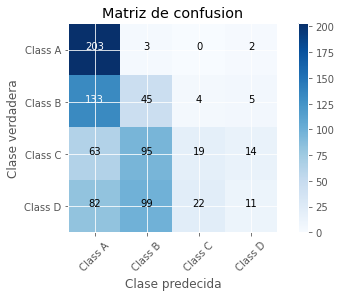

In [18]:
cm=confusion_matrix(real_class_indices,predicted_class_index)
cm_plot_labels=image_train.class_indices
plot_matriz_conf(cm,cm_plot_labels,title="Matriz de confusión")

Matriz de confusion sin normalizar
[[203   3   0   2]
 [133  45   4   5]
 [ 63  95  19  14]
 [ 82  99  22  11]]


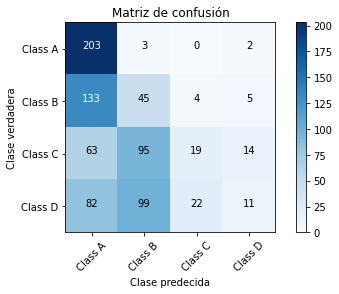

In [14]:
cm=confusion_matrix(real_class_indices,predicted_class_index)
cm_plot_labels=image_train.class_indices
plot_matriz_conf(cm,cm_plot_labels,title="Matriz de confusión")

In [19]:
eva_resp=model.evaluate_generator(test_gen,steps=steps_size_test)
eva_resp

Instructions for updating:
Please use Model.evaluate, which supports generators.


[0.0, 0.0]

In [5]:
path_modelo='./modelos/Vgg19.h5'
model.save(path_modelo)

In [17]:

from time import time
start_time = time()
run_example(path_test+"/test/8184_tipoC.png",path_modelo)
elapsed_time = time() - start_time
print("tiempo total: %0.10f seconds." % elapsed_time)

Clase D
tiempo total: 1.6396157742 seconds.


In [15]:
import sklearn
model = load_model(path_modelo)

sklearn.metrics.accuracy_score(real_class_indices,predicted_class_index)

0.3475